In [22]:
import xgboost
import pandas as pd 
import lasio
import sklearn
import missingno
import numpy as np 
import seaborn as sns
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score

plt.style.use('seaborn-whitegrid')


In [23]:
training_data = pd.read_csv('training_data.csv').iloc[:, 1:]
training_data.head()

,CALI,DEPTH,DTC,GR,NPHI,RDEP,RHOB,SP,WELL,VSHALE
0,17.875000,533.117126,160.908279,65.315254,0.483348,0.246011,2.047,1.995898,15/9-12,0.6718
1,17.813000,533.269531,160.187958,67.185974,0.484852,0.250181,2.045,2.741137,15/9-12,0.6943
2,17.938000,533.421936,160.041489,65.497032,0.487519,0.253092,2.025,2.202385,15/9-12,0.6740
3,17.983999,535.860352,160.842285,74.933800,0.490106,0.241281,2.045,2.059240,15/9-12,0.7874
4,18.063000,536.012756,160.220825,72.307899,0.485749,0.230687,2.047,2.831186,15/9-12,0.7558


In [24]:
test_data = pd.read_csv('blind.csv').iloc[:, 1:]
test_data.isnull().sum()

CALI      108
DEPTH       0
DTC       243
GR          0
NPHI     8593
RDEP        0
RHOB       79
SP          0
WELL        0
dtype: int64

In [25]:
#drop the missing values of the highly correlated features before prediction
test_data.dropna(subset=['DEPTH','RHOB', 'SP', 'GR',
       'DTC', 'RDEP','CALI'],inplace=True)

test_data.isnull().sum()

CALI        0
DEPTH       0
DTC         0
GR          0
NPHI     8512
RDEP        0
RHOB        0
SP          0
WELL        0
dtype: int64

In [26]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn import linear_model

set_NPHI = test_data[['DEPTH','RHOB', 'DTC','RDEP','SP', 'GR',
       'NPHI','CALI']].dropna()  # select features and target log that has value
X = set_NPHI[['DEPTH','RHOB', 'SP', 'GR',
       'DTC', 'RDEP','CALI']]  # feature selection without null value
XX = test_data[['DEPTH','RHOB', 'SP', 'GR',
       'DTC', 'RDEP','CALI']]
y = set_NPHI['NPHI'] # target log
# scaling
scaler = StandardScaler()
X = scaler.fit_transform(X)
X_b = scaler.fit_transform(XX)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [27]:
%%time
MLP_pe = MLPRegressor(random_state=42, max_iter= 500).fit(X_train, y_train) 
MLP_pe.score(X_test, y_test) # examine accuracy

Wall time: 4.21 s


0.9255387674621208

In [28]:
test_data['NPHI_pred'] = MLP_pe.predict(X_b)
test_data['NPHI'].fillna(test_data['NPHI_pred'], inplace =True) 

In [29]:
test_data.isnull().sum()

CALI         0
DEPTH        0
DTC          0
GR           0
NPHI         0
RDEP         0
RHOB         0
SP           0
WELL         0
NPHI_pred    0
dtype: int64

In [30]:
# transform deep resistivity to logarithmic scale
test_data['RDEP'] = np.log10(test_data['RDEP'])

In [31]:
from sklearn.ensemble import IsolationForest

def outlier_removal(df, ind=-1):

    log_header = ['DEPTH','WELL','CALI','DTC', 'GR', 'NPHI', 'RDEP', 'RHOB', 'SP']
    print('Before anomaly treatment\n',df.drop(['WELL', 'DEPTH'], axis=1).describe())
    # major parameter percentage of outlier present with parameter contamination, nu : 3 %
    outliers_frac = 0.03
    # define outlier/anomaly detection methods to be compared
    anomaly_algorithm = [('Isolation Forest', IsolationForest(n_estimators=100, max_samples='auto',
                         contamination=outliers_frac, random_state=42))]
        
    fig = plt.figure(figsize=(15, 10))
    fig.subplots_adjust(hspace=0.4, wspace=0.6)
    fig.suptitle('Anomaly detection using Isolation Forest')

# detect anomaly for each features
    for i, item in enumerate(log_header[2:]):
        temp = 171+i  # this is to index the position of the subplot
        plt.subplot(temp)
        # Automatic anomaly flagging on whole data sample with inliers labeled as 1 and outliers labeled as -1
        anomaly = anomaly_algorithm[0][1].fit_predict(df[[item]])
        plt.scatter(df[item], df.DEPTH, label='original', marker='o',s=4)
        plt.scatter(df[item][anomaly==-1], df.DEPTH[anomaly==-1],
                        marker='^', label='outliers',s=4)
        plt.xlabel(item)
        plt.ylabel('DEPTH')
        plt.gca().invert_yaxis()
        plt.legend(loc='upper right')
 
        print('\nNumber of anomalies detected for', item, '=', -sum(anomaly[anomaly==-1]),'out of', anomaly.shape[0])
        counter = np.zeros(df.shape[0])
        counter += anomaly

        df = df[anomaly==1]
        print('Number of data points after anomalies removal =',df.shape[0])
    
    print('After anomaly treatment\n',df.drop(['WELL', 'DEPTH'], axis=1).describe())
    return df

Before anomaly treatment
                CALI           DTC            GR          NPHI          RDEP  \
count  35837.000000  35837.000000  35837.000000  35837.000000  35837.000000   
mean      14.416569    124.531433     61.443598      0.415732      0.096633   
std        4.149034     30.301181     29.273994      0.131212      0.287614   
min        5.293224     54.643066      5.633000      0.037920     -0.586700   
25%       12.115748     91.972397     42.500000      0.331540     -0.111253   
50%       13.935694    139.377579     64.436150      0.467624      0.071151   
75%       17.672001    146.444244     78.387115      0.504890      0.265051   
max       25.726528    176.121902    811.000000      0.807007      1.717238   

               RHOB            SP     NPHI_pred  
count  35837.000000  35837.000000  35837.000000  
mean       2.139250     73.730166      0.398916  
std        0.237716     28.531660      0.132228  
min        1.440683     21.934605     -0.004426  
25%        1

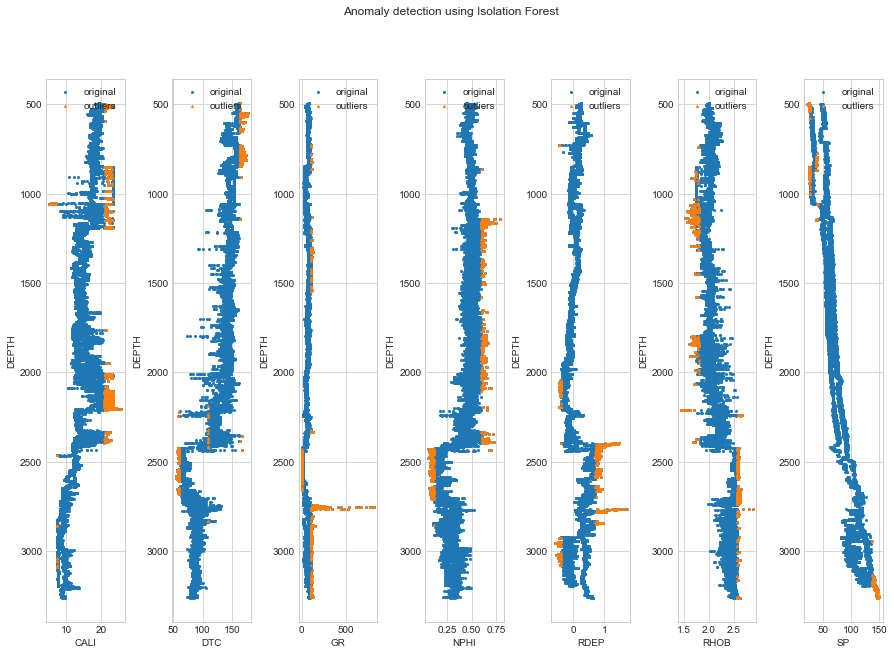

In [32]:
data = outlier_removal(test_data, ind=-1)

In [33]:
data.isnull().sum()

CALI         0
DEPTH        0
DTC          0
GR           0
NPHI         0
RDEP         0
RHOB         0
SP           0
WELL         0
NPHI_pred    0
dtype: int64

In [34]:
from sklearn.model_selection import train_test_split

train , test = train_test_split(training_data, test_size = 0.2)

x_train = train[['CALI','DEPTH','NPHI','RDEP','RHOB','SP','GR']]
y_train = train['DTC']


x_test = test[['CALI','DEPTH','NPHI','RDEP','RHOB','SP','GR']]
y_test = test['DTC']

In [35]:
import xgboost as xgb
XGB = xgb.sklearn.XGBRegressor(random_state=42)
XGB.fit(x_train,y_train, early_stopping_rounds=10, eval_metric='rmse', eval_set=[(x_train,y_train)])  

[0]	validation_0-rmse:85.78438
[1]	validation_0-rmse:60.22463
[2]	validation_0-rmse:42.37382
[3]	validation_0-rmse:29.94353
[4]	validation_0-rmse:21.32377
[5]	validation_0-rmse:15.41172
[6]	validation_0-rmse:11.40007
[7]	validation_0-rmse:8.78026
[8]	validation_0-rmse:7.08211
[9]	validation_0-rmse:6.06314
[10]	validation_0-rmse:5.45152
[11]	validation_0-rmse:5.09483
[12]	validation_0-rmse:4.87476
[13]	validation_0-rmse:4.73193
[14]	validation_0-rmse:4.64354
[15]	validation_0-rmse:4.57626
[16]	validation_0-rmse:4.50748
[17]	validation_0-rmse:4.47000
[18]	validation_0-rmse:4.43746
[19]	validation_0-rmse:4.42395
[20]	validation_0-rmse:4.37475
[21]	validation_0-rmse:4.34327
[22]	validation_0-rmse:4.32856
[23]	validation_0-rmse:4.31114
[24]	validation_0-rmse:4.29409
[25]	validation_0-rmse:4.27456
[26]	validation_0-rmse:4.24800
[27]	validation_0-rmse:4.24427
[28]	validation_0-rmse:4.20707
[29]	validation_0-rmse:4.18711
[30]	validation_0-rmse:4.17623
[31]	validation_0-rmse:4.14705
[32]	valida

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=8, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

## Training

In [36]:
from sklearn.metrics import r2_score
prediction_train = XGB.predict(x_train)
r_squared = r2_score(prediction_train, y_train)
r_squared

0.9865336570486763

## Validation

In [37]:
from sklearn.metrics import r2_score

predictions = XGB.predict(x_test)
r2=r2_score(predictions,y_test)

r2

0.981251598397503

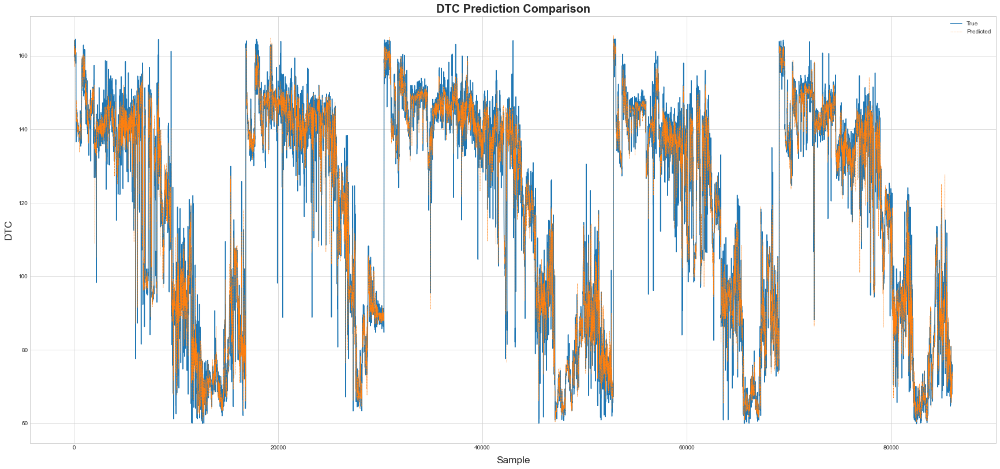

In [41]:
results = pd.DataFrame()
results['Test Data']=y_test

results['predictions']=predictions
results = results.sort_index()

plt.figure(figsize=(30,30))
plt.subplot(2 , 1, 1)
plt.plot(results['Test Data'])
plt.plot(results['predictions'], '--',linewidth=0.5)
plt.legend(['True', 'Predicted'])
plt.xlabel('Sample',size = 'xx-large',labelpad = 10)
plt.ylabel('DTC',size = 'xx-large',labelpad = 10)
plt.title('DTC Prediction Comparison',size=20,weight='bold')
plt.show()

In [42]:
XGB.feature_importances_

array([0.01192171, 0.68112874, 0.03575478, 0.02492137, 0.1485462 ,
       0.01347607, 0.08425112], dtype=float32)

Text(0, 0.5, 'Features')

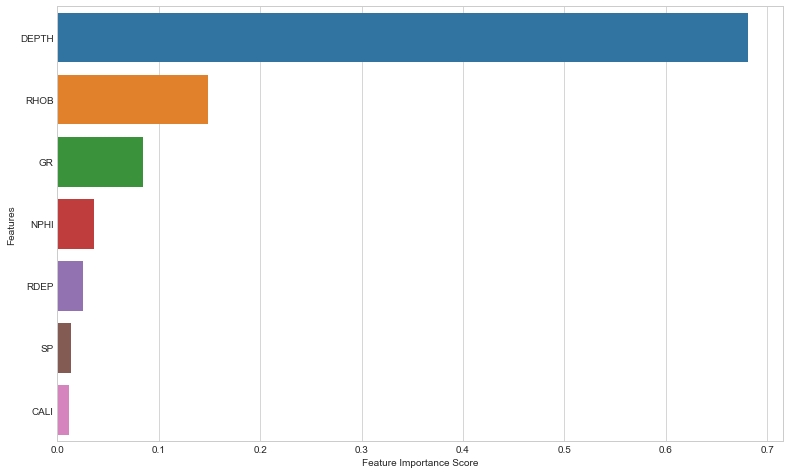

In [43]:
plt.figure(figsize=(13,8))
feature_imp=pd.Series(XGB.feature_importances_,
index=['CALI','DEPTH','NPHI','RDEP','RHOB','SP','GR']).sort_values(ascending=False)
sns.barplot(x=feature_imp, y=feature_imp.index)
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')

In [ ]:
# from sklearn.inspection import permutation_importance

# perm_importance = permutation_importance(XGB, x_test, y_test)
# plt.figure(figsize=(15,10))

# sorted_idx = perm_importance.importances_mean.argsort()
# plt.barh(x_train.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
# plt.xlabel("Permutation Importance")

## Hiperparameter tuning

In [ ]:
# grid_random = {'max_depth': [3, 6, 10],
#               'min_child_weight': np.arange(1, 10, 1),
#               'gamma': np.arange(0, 10, 1),
#               'n_estimators': [100, 1000],
#               'learning_rate': [0.01, 0.1, 0.2],
#               'subsample': np.arange(0.5, 1.0, 0.1)}

# from sklearn.model_selection import RandomizedSearchCV

# model = xgb.sklearn.XGBRegressor(objective = 'reg:squarederror')

# model_random = RandomizedSearchCV(estimator = model, param_distributions = grid_random, n_iter = 100, 
#                                  cv = 5, verbose = 2, random_state = 42, n_jobs = -1)

# model_random.fit(x_train, y_train)

In [44]:
XGB = xgb.sklearn.XGBRegressor(n_estimators= 1000, colsample_bytree= 0.8, learning_rate= 0.01, max_depth= 6, min_child_weight= 1, subsample= 0.7)
XGB.fit(x_train,y_train, early_stopping_rounds=10, eval_metric='rmse', eval_set=[(x_train,y_train)]) 

[0]	validation_0-rmse:121.12280
[1]	validation_0-rmse:119.91631
[2]	validation_0-rmse:118.72280
[3]	validation_0-rmse:117.54015
[4]	validation_0-rmse:116.36981
[5]	validation_0-rmse:115.21247
[6]	validation_0-rmse:114.06486
[7]	validation_0-rmse:112.92878
[8]	validation_0-rmse:111.80780
[9]	validation_0-rmse:110.69474
[10]	validation_0-rmse:109.59265
[11]	validation_0-rmse:108.50542
[12]	validation_0-rmse:107.42508
[13]	validation_0-rmse:106.35783
[14]	validation_0-rmse:105.30090
[15]	validation_0-rmse:104.25700
[16]	validation_0-rmse:103.21982
[17]	validation_0-rmse:102.19317
[18]	validation_0-rmse:101.17643
[19]	validation_0-rmse:100.17172
[20]	validation_0-rmse:99.17474
[21]	validation_0-rmse:98.18777
[22]	validation_0-rmse:97.21326
[23]	validation_0-rmse:96.24621
[24]	validation_0-rmse:95.29093
[25]	validation_0-rmse:94.34323
[26]	validation_0-rmse:93.40527
[27]	validation_0-rmse:92.47609
[28]	validation_0-rmse:91.55709
[29]	validation_0-rmse:90.64682
[30]	validation_0-rmse:89.7455

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.8, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.01, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=1000, n_jobs=8, num_parallel_tree=1, random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.7,
             tree_method='exact', validate_parameters=1, verbosity=None)

## Training

In [45]:
prediction_train = XGB.predict(x_train)
r_squared = r2_score(prediction_train, y_train)
r_squared

0.9802840263632204

## Validation

In [46]:
predictions = XGB.predict(x_test)
r2=r2_score(predictions,y_test)

r2

0.9775367679174811

## Blind data

In [47]:
test_data = data

In [48]:
# Define the test data 
wells = ['15/9-13','15/9-15']
X_test = []
y_test = []
depths = []
for i in range(len(wells)):
  # split the df with respect to its name
  test = test_data.loc[test_data['WELL'] == wells[i]]

  # Drop well name column 
  test = test.drop(['WELL'],axis=1)

  # define X_test (feature)
  X_test_ = test[['CALI','DEPTH','NPHI','RDEP','RHOB','SP','GR']].values
  
  y_test_ = test_data.loc[test_data['WELL'] == wells[i]]['DTC'].values

  # define depth
  depth_ = test_data.loc[test_data['WELL'] == wells[i]]['DEPTH'].values
  
  X_test.append(X_test_)
  depths.append(depth_)
  y_test.append(y_test_)

# for each well 
X_test1, X_test2 = X_test
depth1, depth2 = depths
y_test1, y_test2 = y_test

In [49]:
y_pred1 = XGB.predict(X_test1)
y_pred2 = XGB.predict(X_test2)

In [50]:
#well '15/9-13'
print("R-squared of Well 15/9-13: {}".format(XGB.score(X_test1, y_test1)))
gb_rmse = np.sqrt(mean_squared_error(y_test1, y_pred1))
print("RMSE of Well 15/9-13: {}".format(gb_rmse))

#well '15/9-15'
print("R-squared of Well 15/9-15: {}".format(XGB.score(X_test2, y_test2)))
gb2_rmse = np.sqrt(mean_squared_error(y_test2, y_pred2))
print("RMSE of Well 15/9-15: {}".format(gb2_rmse))

R-squared of Well 15/9-13: 0.9283431405740462
RMSE of Well 15/9-13: 7.280382435836808
R-squared of Well 15/9-15: 0.9275495181714422
RMSE of Well 15/9-15: 7.170301119412396


In [51]:
def plot(pred1, pred2, title): 
    fig = plt.figure(figsize=(7,10))

    ax1 = plt.subplot(1,2,1)
    plt.plot(test_data.loc[test_data['WELL'] == wells[0],'DTC'], depth1, color='blue', label='Actual',linewidth=0.5)
    plt.ylim(max(depth1), min(depth1))
    plt.title('Actual DTC Well 15/9-13', size=12)
    plt.ylabel('Depth (m)',size='xx-large',labelpad = 10)

    ax1.plot(pred1, depth1, color='orange', linestyle='--',label='Predicted',linewidth=0.5)
    plt.ylim(max(depth1), min(depth1))
    plt.title('DTC Well 15/9-13', size=12)
    plt.legend()
    plt.text(80, 750, f'r^2 = {np.round(XGB.score(X_test1, y_test1),2)}', fontsize = 10, 
        bbox = dict(facecolor = 'grey', alpha = 0.5))

    ax2 = plt.subplot(1,2,2)
    plt.plot(test_data.loc[test_data['WELL'] == wells[1],'DTC'], depth2, color='blue', label='Actual', linewidth=0.5)
    plt.ylim(max(depth2), min(depth2))

    ax2.plot(pred2, depth2, color='orange', linestyle='--',label='Predicted',linewidth=0.5)
    plt.ylim(max(depth2), min(depth2))
    plt.title('DTC Well 15/9-15',size=12)
    plt.legend()
    plt.text(80, 750, f'r^2 = {np.round(XGB.score(X_test1, y_test1),2)}', fontsize = 10,   
    bbox = dict(facecolor = 'grey', alpha = 0.5))

    plt.tight_layout()
    plt.show()

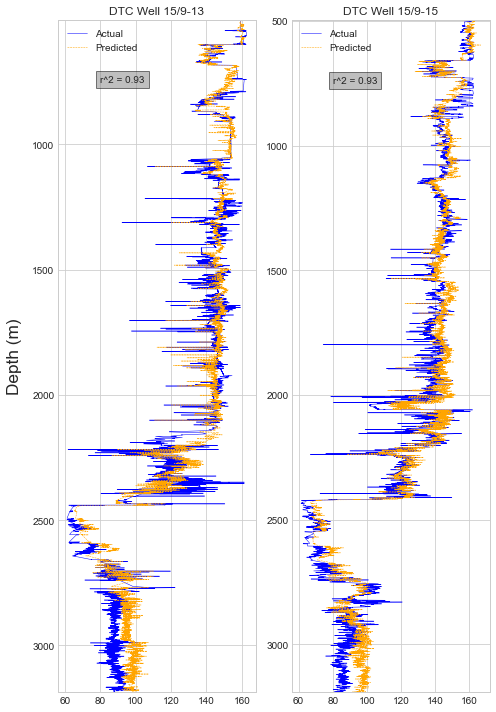

In [52]:
plot(y_pred1,y_pred2,'XGB Regressor')

In [64]:
def reg(pred1, pred2): 

    sns.set(rc={"figure.figsize":(10, 10)})
    sns.set_style('whitegrid')
    fig, (ax1, ax2) = plt.subplots(2)

    sns.regplot(x=test_data.loc[test_data['WELL'] == wells[0],'DTC'], 
                y=y_pred1, ax=ax1,line_kws={"color": "black","linestyle":'--'})
    ax1.set_title('Well 15/9-13',size=15, weight='bold', pad=15)
    ax1.set_xlabel('')
    ax1.grid(False)

    sns.regplot(x=test_data.loc[test_data['WELL'] == wells[-1],'DTC'], 
                y=y_pred2, ax=ax2,line_kws={"color": "black","linestyle":'--'})
    ax2.set_title('Well 15/9-15',size=15, weight='bold', pad=15)
    ax2.set_ylabel('Predicted RHOB',size=13,labelpad = 10)
    ax2.set_xlabel('')
    ax2.grid(False)

    plt.tight_layout()
  

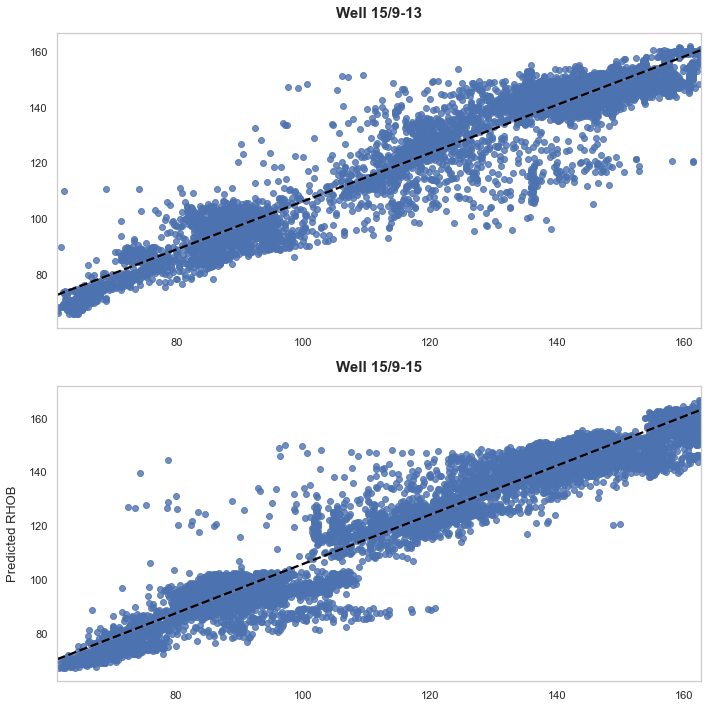

In [65]:
reg(y_pred1,y_pred2)

In [66]:
# Saving model to disk
import pickle
pickle.dump(XGB, open('model.pkl','wb'))

In [ ]:
#y_pred1.to_csv('15/9-13.csv')
#y_pred2.to_csv('15/9-15.csv')